In [1]:
import sys
print(sys.version)
print(sys.executable)

3.8.17 (default, Jul  5 2023, 21:04:15) 
[GCC 11.2.0]
/public3/home/scg6055/.conda/envs/py38/bin/python


In [3]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an

from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
from deside.utility import check_dir
from deside.utility import log_exp2cpm,non_log2cpm,non_log2log_cpm
sns.set()

In [4]:
result_dir = os.path.join(r'../results/3CA/Data_Dong2020_Prostate')
data_set_name = str('all_PRAD_Commun_Biol_Dong_2020_merged')
check_dir(result_dir)

In [5]:
gene_name_path = r'../data/3CA/Data_Dong2020_Prostate/Genes.txt'
cell_information_path = r'../data/3CA/Data_Dong2020_Prostate/Cells.csv'
gene_name = pd.read_csv(gene_name_path,sep=',',header =None,index_col=0)
cell_information = pd.read_csv(cell_information_path,sep=',',index_col=0,header =0)
print(gene_name.shape)
print(cell_information.shape)
anno = cell_information.copy()


(15709, 0)
(21292, 3)


In [6]:
data_path = r'../data/3CA/Data_Dong2020_Prostate/Exp_data_UMIcounts.mtx'
all_dataset = sc.read(data_path)
all_dataset = all_dataset.T
print(all_dataset.shape)   #(21292, 15709)

(21292, 15709)


758844.1901727198
758844.1901727198


(array([    0.,     0.,     0.,     0.,     0., 21292.,     0.,     0.,
            0.,     0.]),
 array([ 999999.5,  999999.6,  999999.7,  999999.8,  999999.9, 1000000. ,
        1000000.1, 1000000.2, 1000000.3, 1000000.4, 1000000.5]),
 <BarContainer object of 10 artists>)

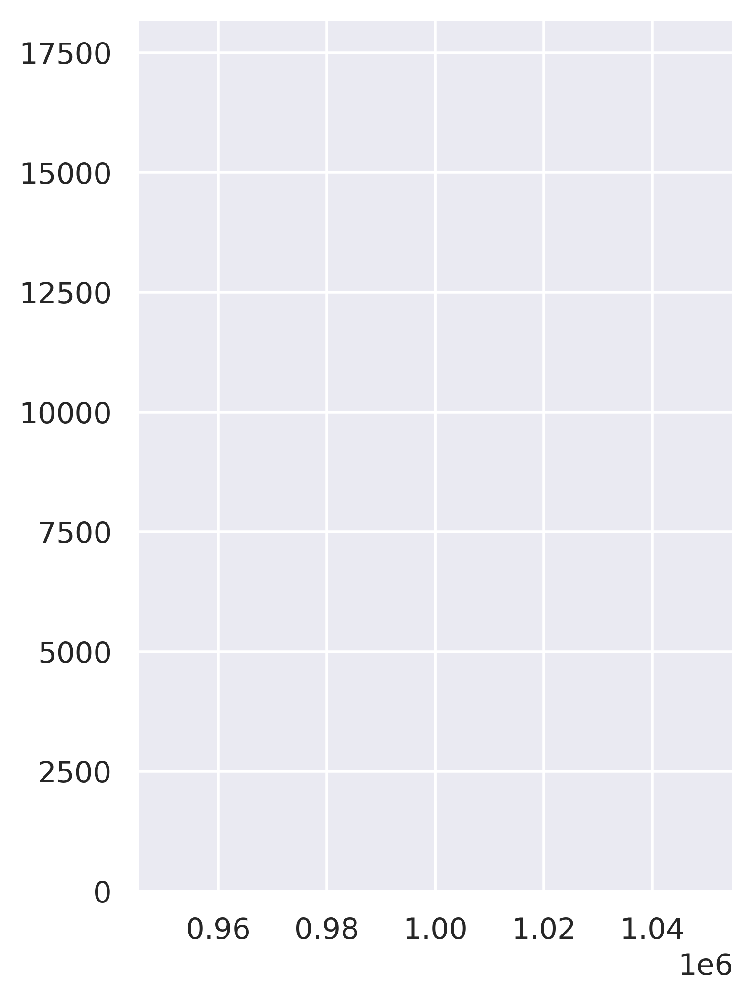

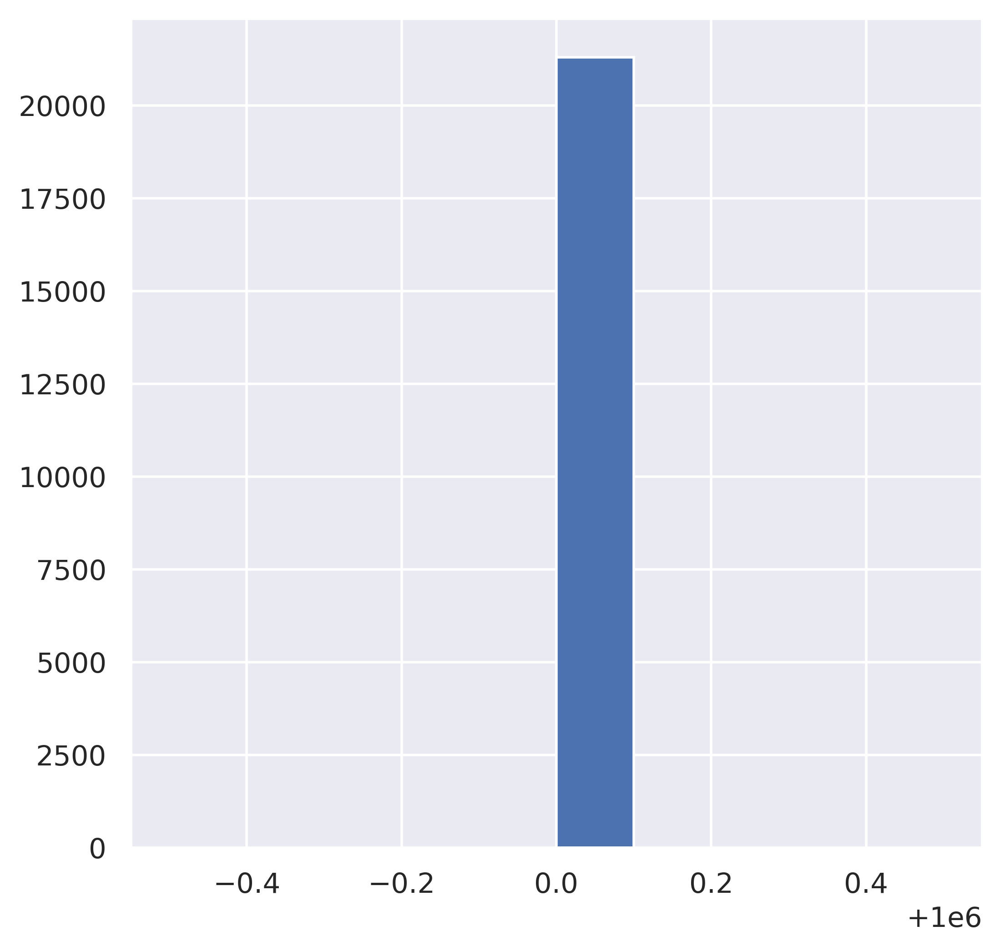

In [9]:

data = all_dataset.X
data = pd.DataFrame( data.todense())  
plt.figure(figsize=(4,6))
print(data.max().max())
ax = plt.hist(data.sum(axis=1))
data = non_log2cpm(exp_df=data)   #CHECK
print(data.max().max())
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))



#16498 sample


In [10]:
all_dataset = an.AnnData(data)
all_dataset.X = csr_matrix(all_dataset.X)
all_dataset

AnnData object with n_obs × n_vars = 21292 × 15709

In [11]:
all_dataset.var.index = gene_name.index
all_dataset.obs = cell_information
all_dataset.obs = all_dataset.obs.rename(columns ={'sample':'sample_id'})
all_dataset

AnnData object with n_obs × n_vars = 21292 × 15709
    obs: 'sample_id', 'cell_type', 'complexity'

In [12]:
for col in all_dataset.obs.columns:
    all_dataset.obs[col] = all_dataset.obs[col].astype(str)

all_dataset.obs.dtypes

sample_id     object
cell_type     object
complexity    object
dtype: object

In [13]:
all_dataset.var.index.name = 'gene_name'

In [14]:
all_dataset.var

""
gene_name
TSPAN6
DPM1
SCYL3
C1orf112
FGR
...
LINC00891
LINC01144
ADORA3


In [15]:
all_files = list(all_dataset.obs['sample_id'].unique())
print(len(all_files))
print(all_dataset.obs['sample_id'].value_counts())


6
patient #5    8690
patient #6    6603
patient #1    3022
patient #4    1062
patient #3     965
patient #2     950
Name: sample_id, dtype: int64


#----------------------------------------------
Deal with patient #1...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (3022, 15709)


<Figure size 3000x600 with 0 Axes>

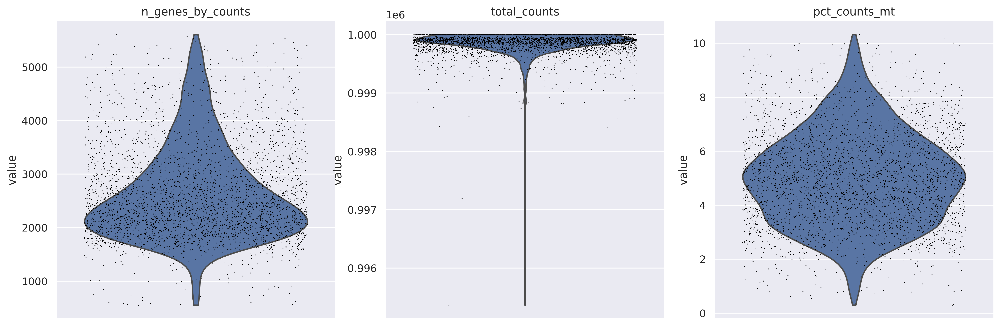

<Figure size 1600x1200 with 0 Axes>

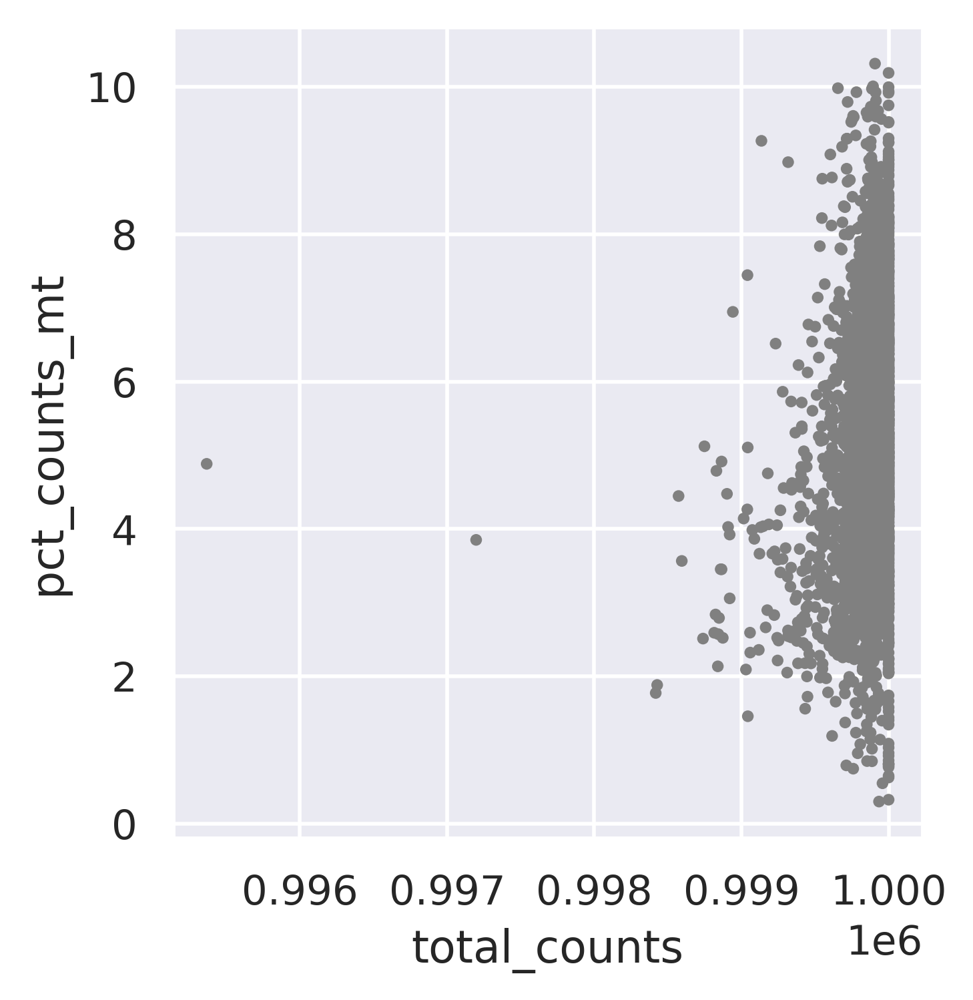

<Figure size 1600x1200 with 0 Axes>

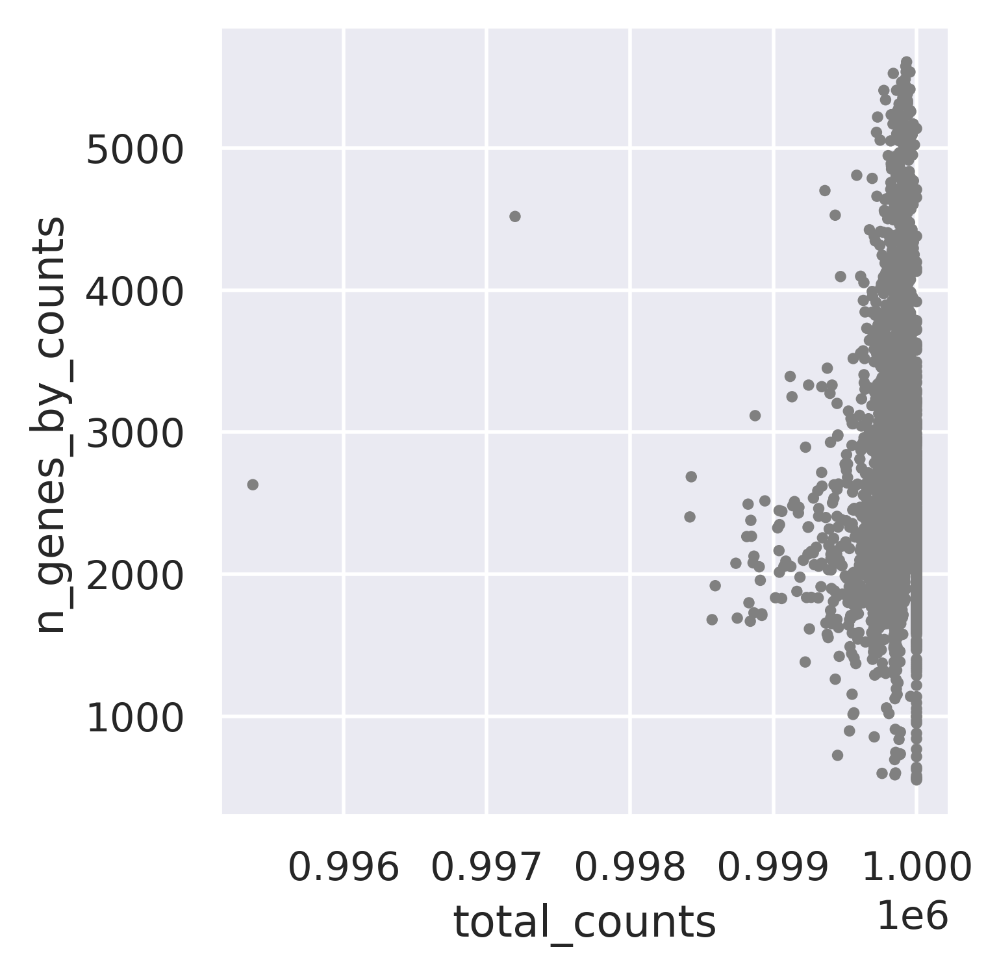

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (3019, 14266)
#----------------------------------------------
Deal with patient #2...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (950, 15709)


<Figure size 3000x600 with 0 Axes>

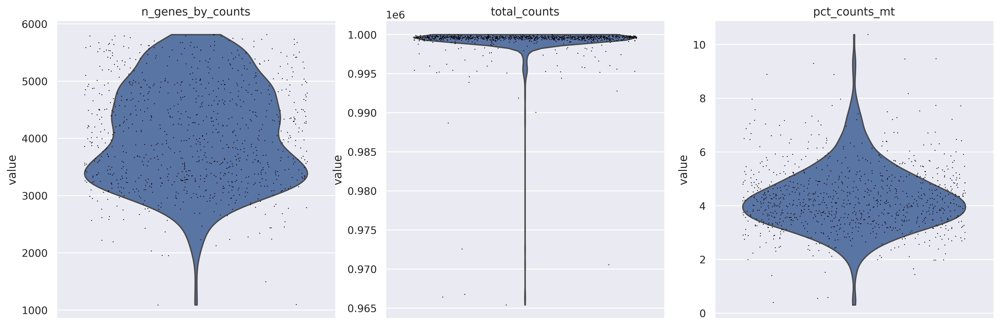

<Figure size 1600x1200 with 0 Axes>

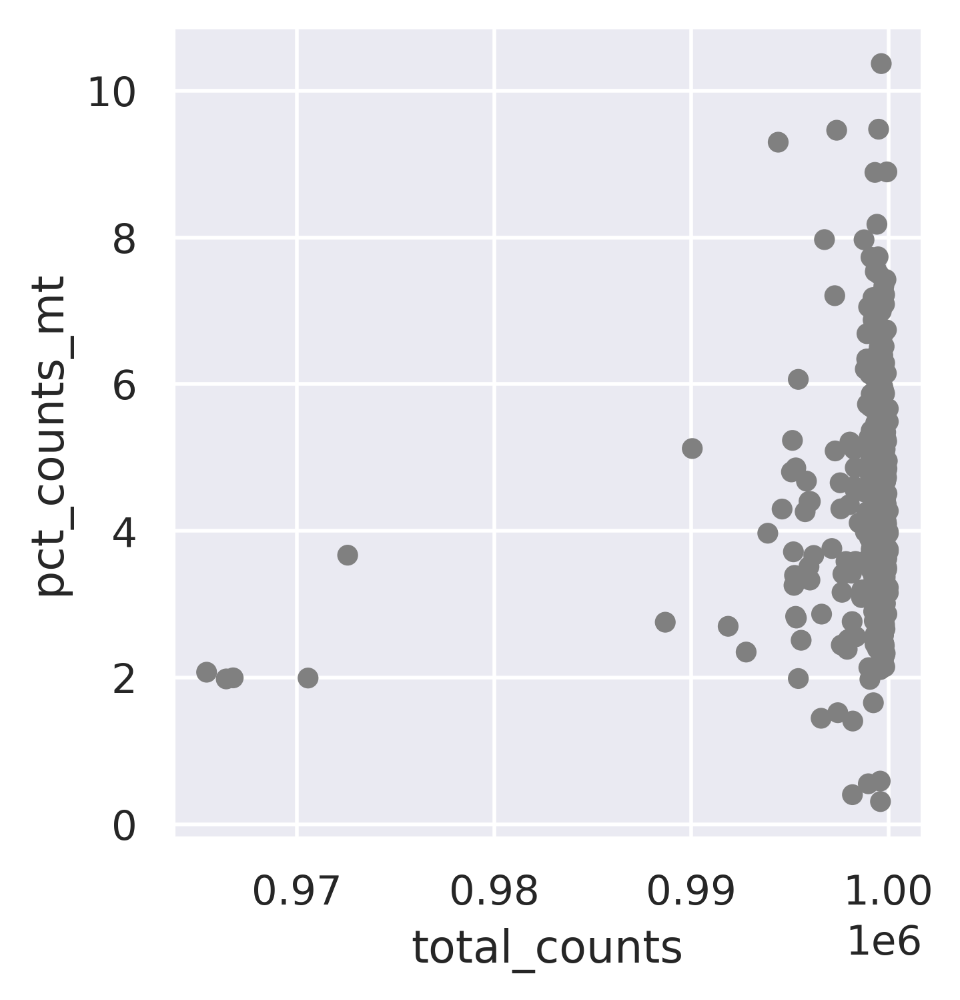

<Figure size 1600x1200 with 0 Axes>

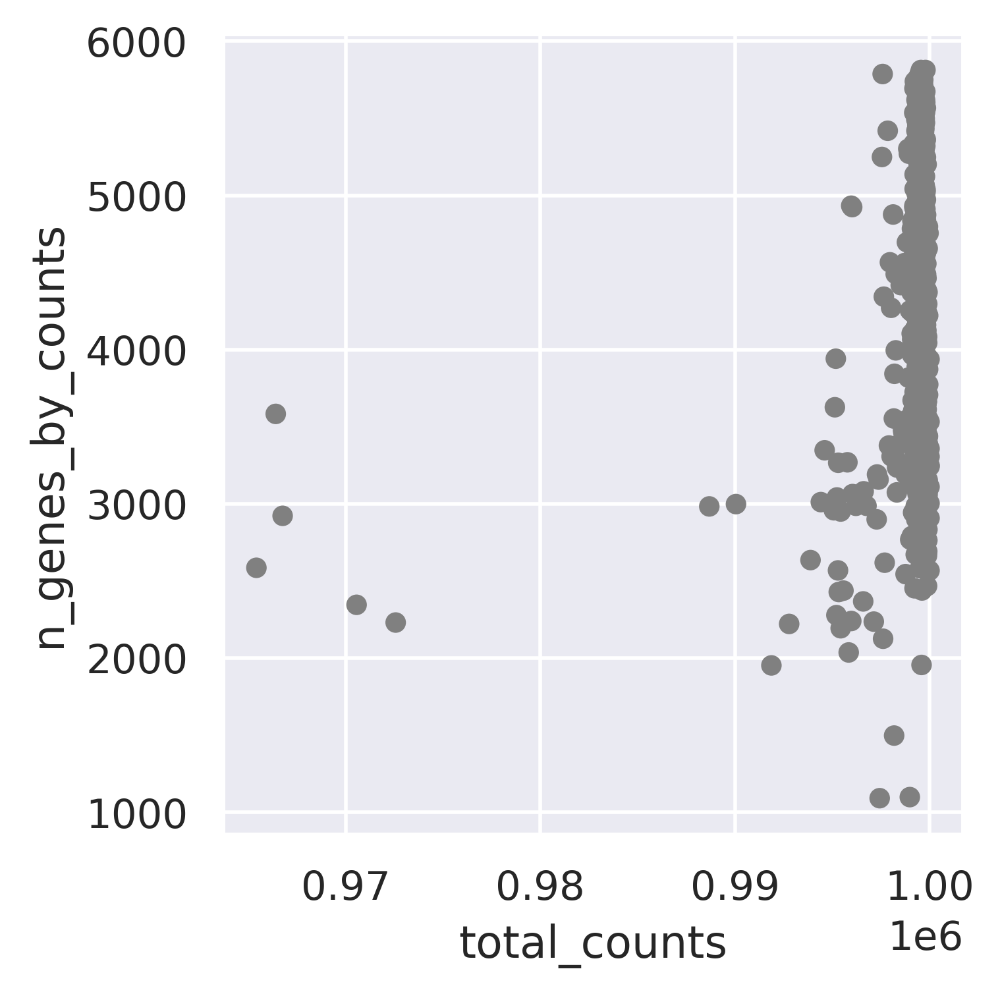

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (949, 13329)
#----------------------------------------------
Deal with patient #3...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (965, 15709)


<Figure size 3000x600 with 0 Axes>

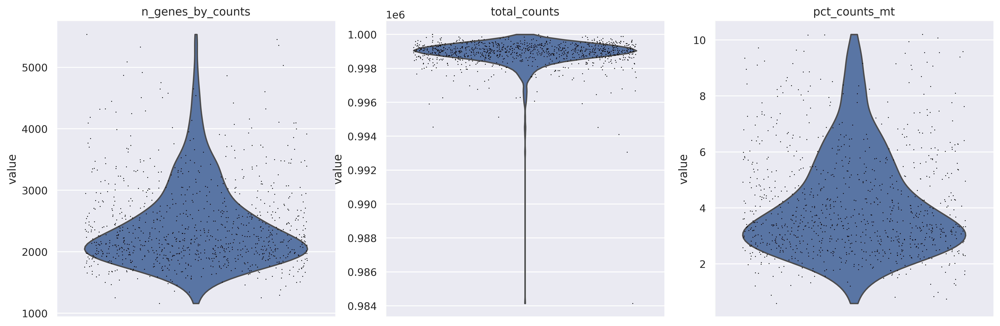

<Figure size 1600x1200 with 0 Axes>

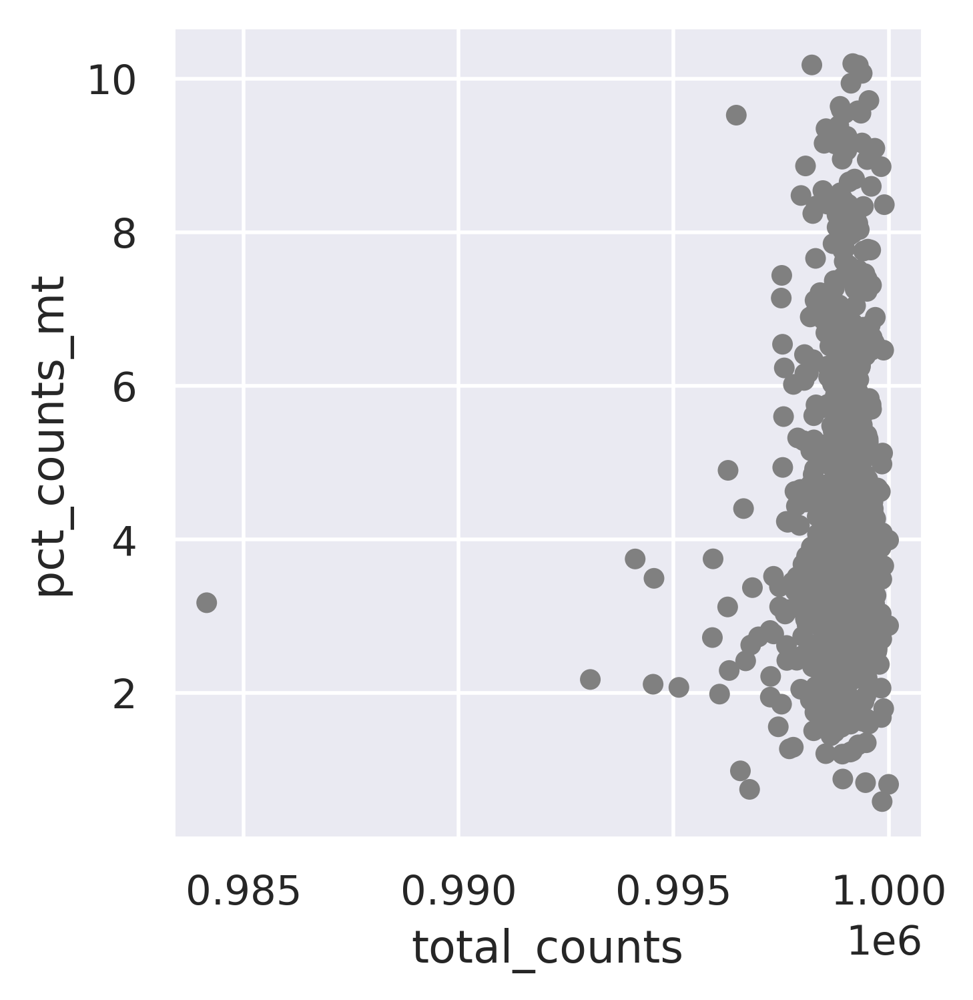

<Figure size 1600x1200 with 0 Axes>

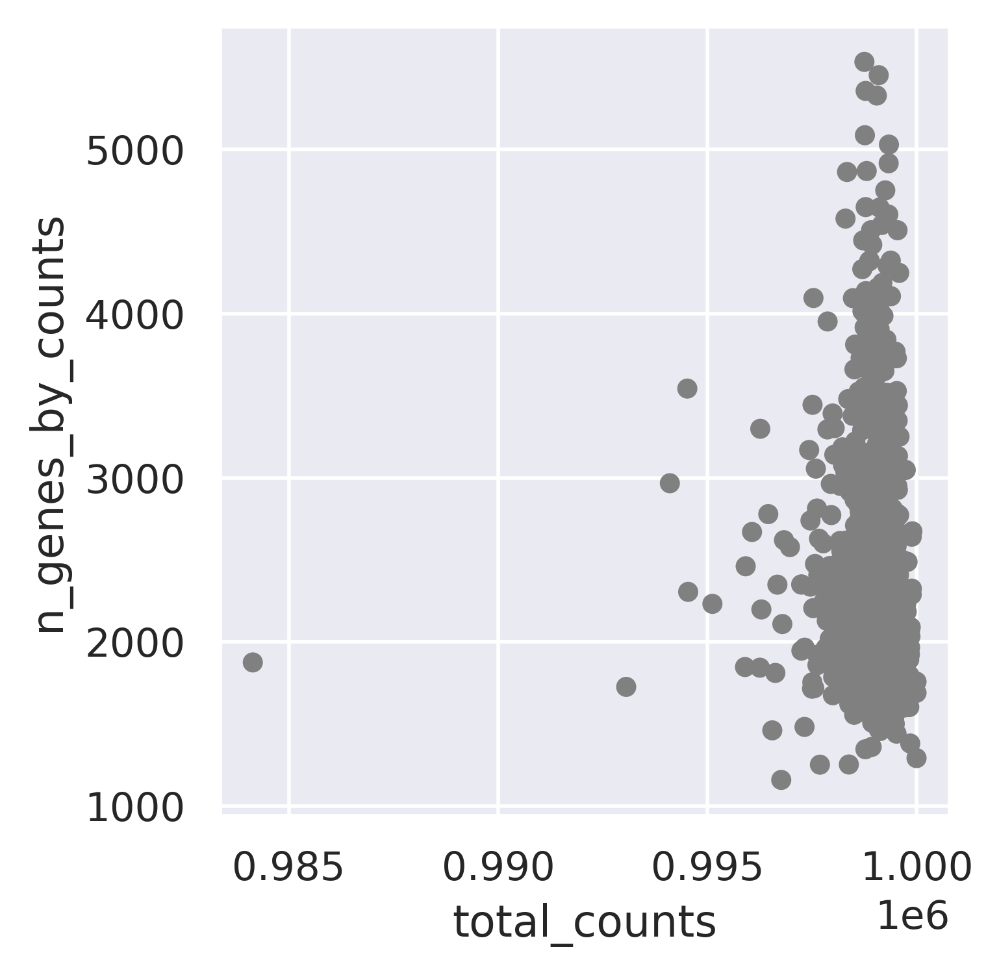

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (961, 13324)
#----------------------------------------------
Deal with patient #4...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1062, 15709)


<Figure size 3000x600 with 0 Axes>

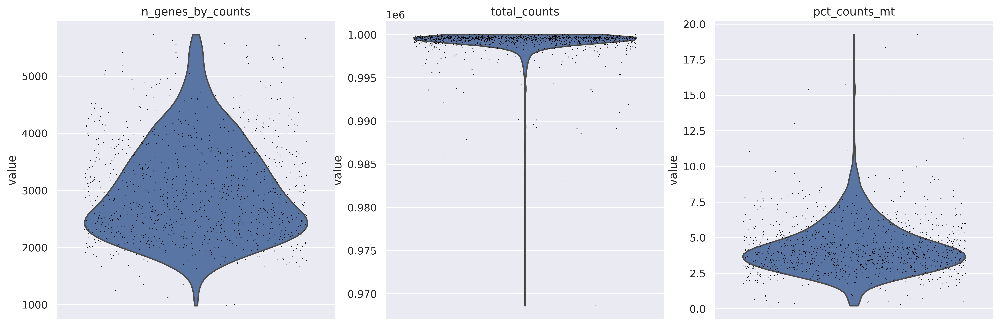

<Figure size 1600x1200 with 0 Axes>

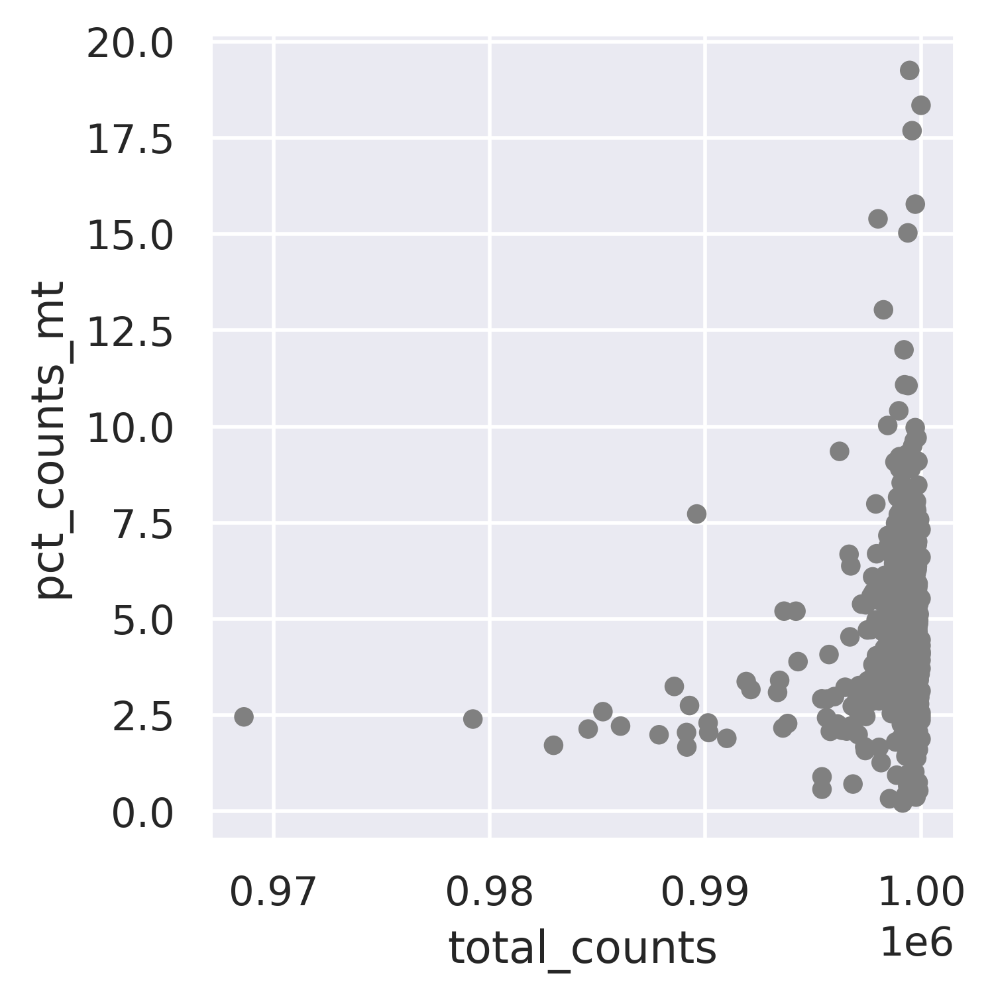

<Figure size 1600x1200 with 0 Axes>

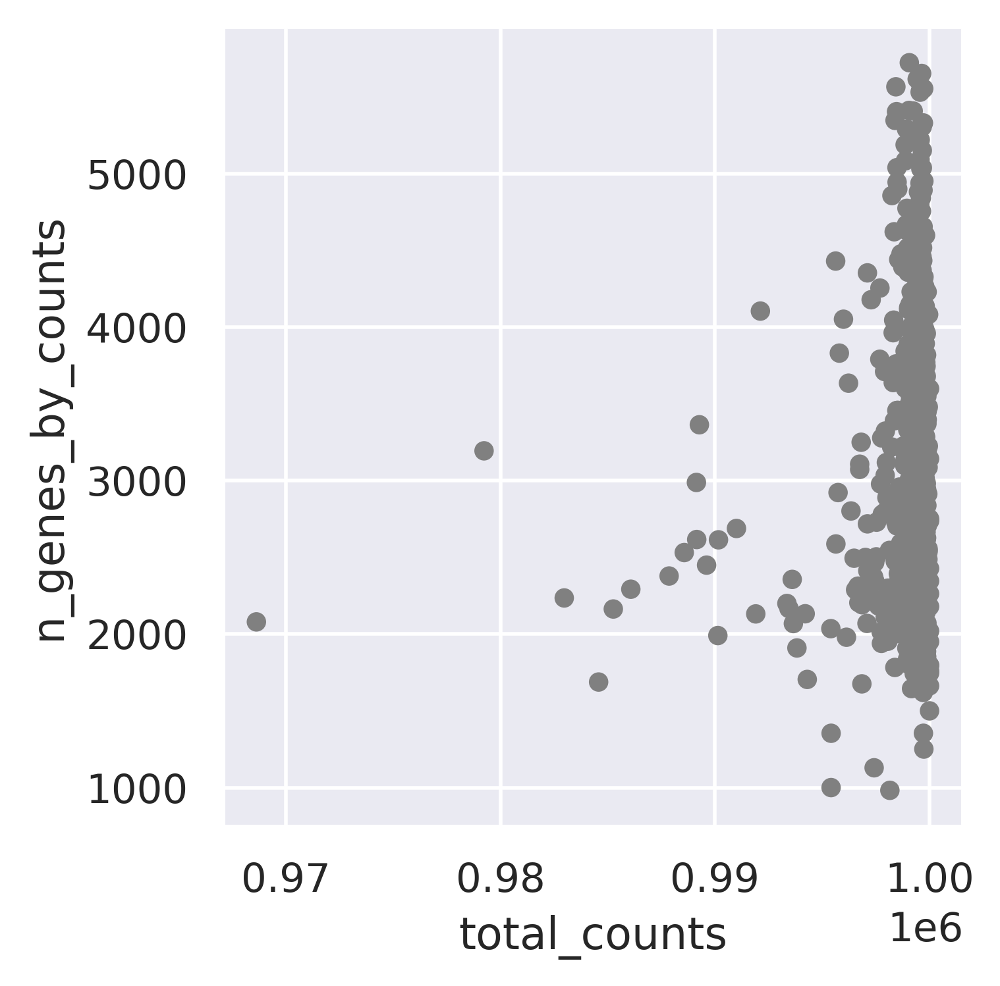

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1050, 13086)
#----------------------------------------------
Deal with patient #5...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (8690, 15709)


<Figure size 3000x600 with 0 Axes>

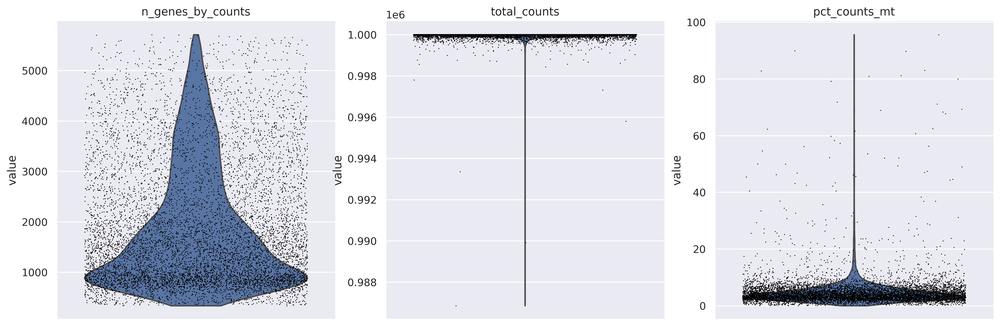

<Figure size 1600x1200 with 0 Axes>

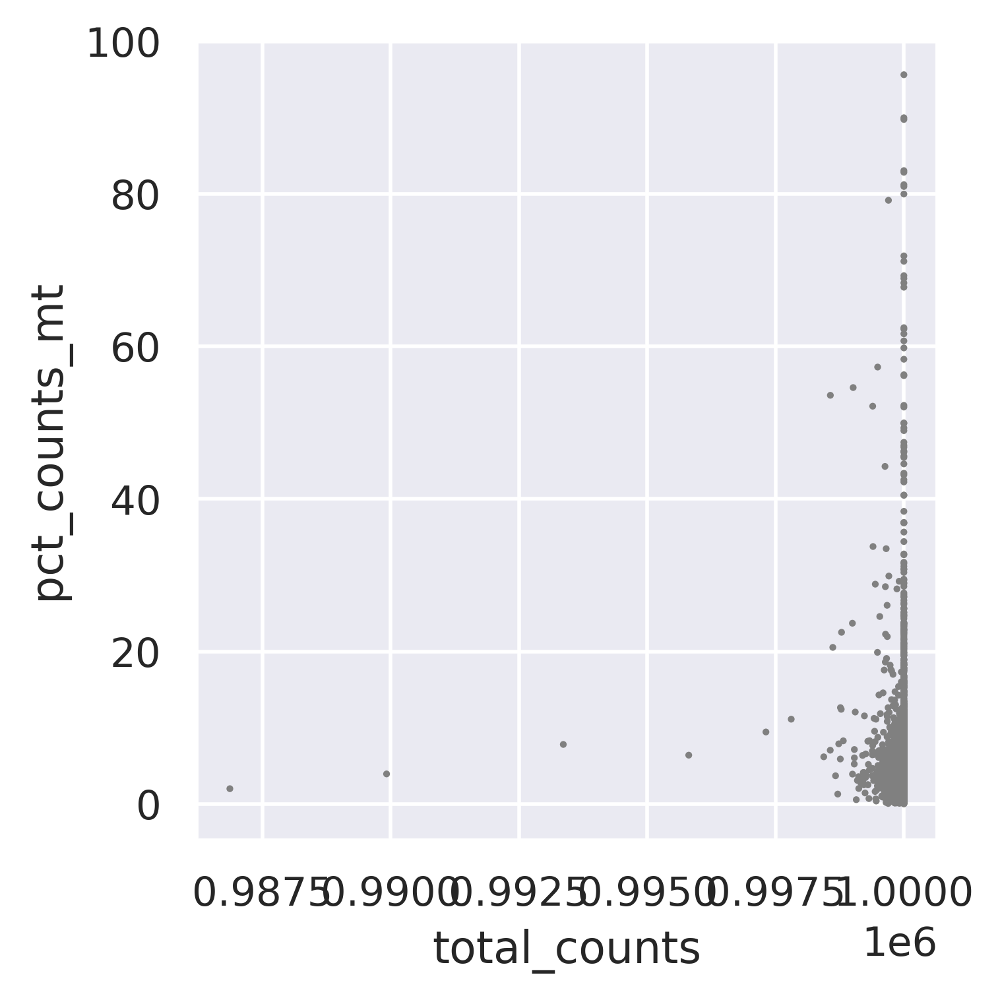

<Figure size 1600x1200 with 0 Axes>

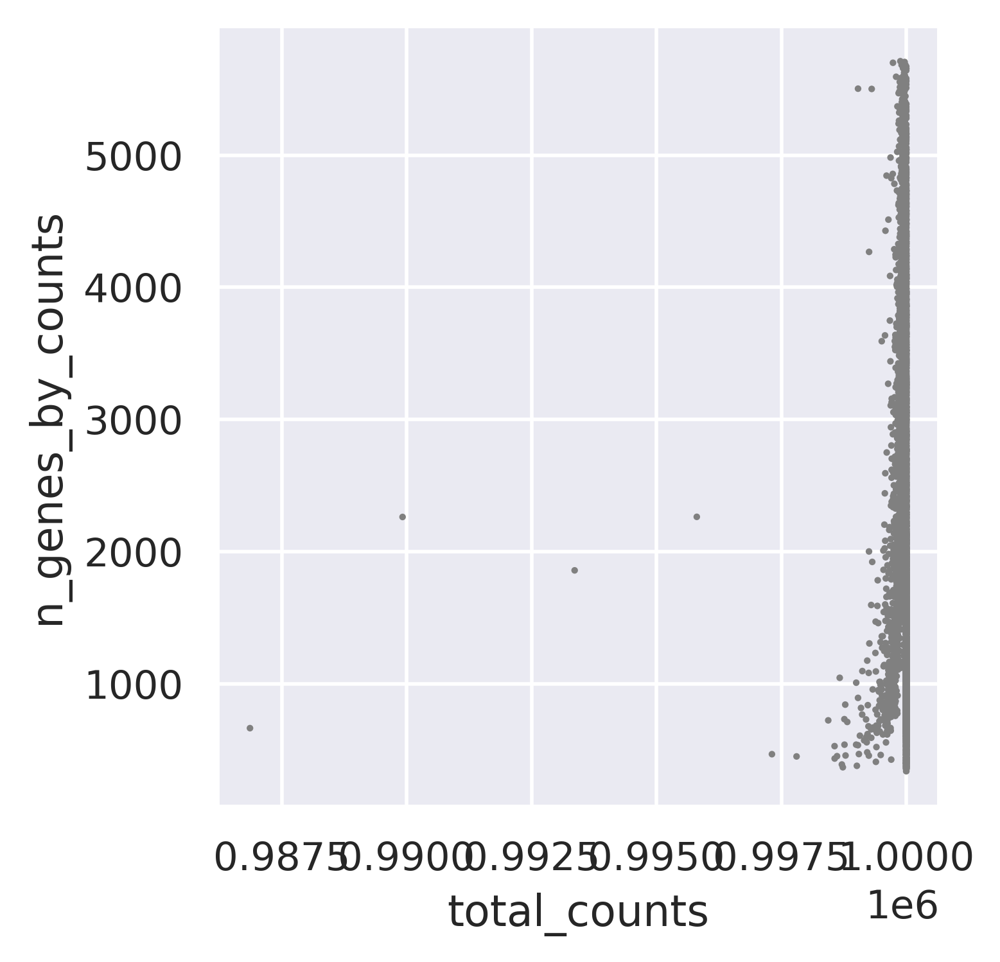

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (8275, 15053)
#----------------------------------------------
Deal with patient #6...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (6603, 15709)


<Figure size 3000x600 with 0 Axes>

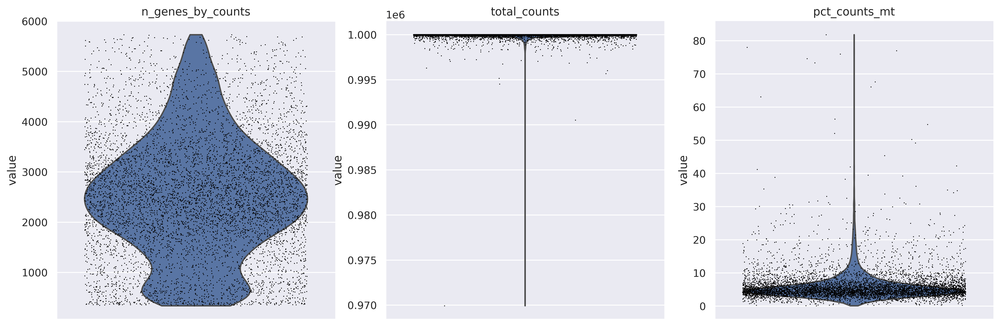

<Figure size 1600x1200 with 0 Axes>

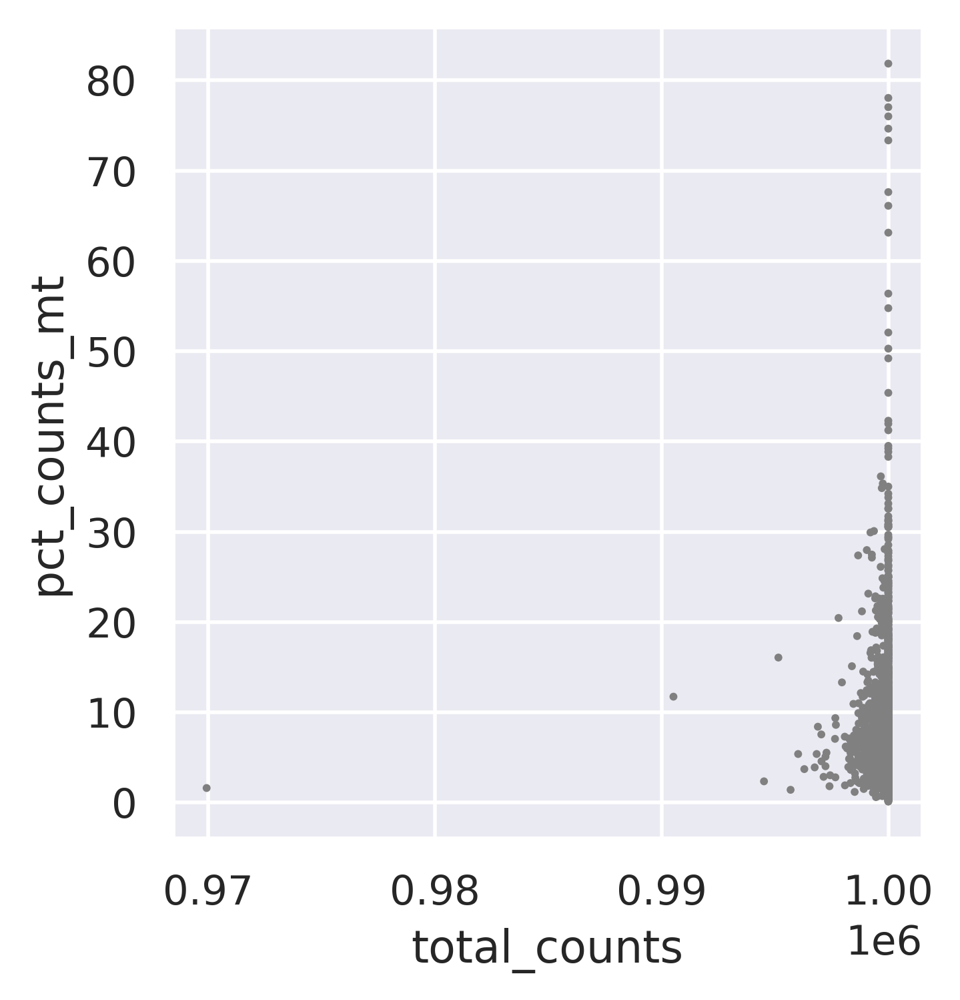

<Figure size 1600x1200 with 0 Axes>

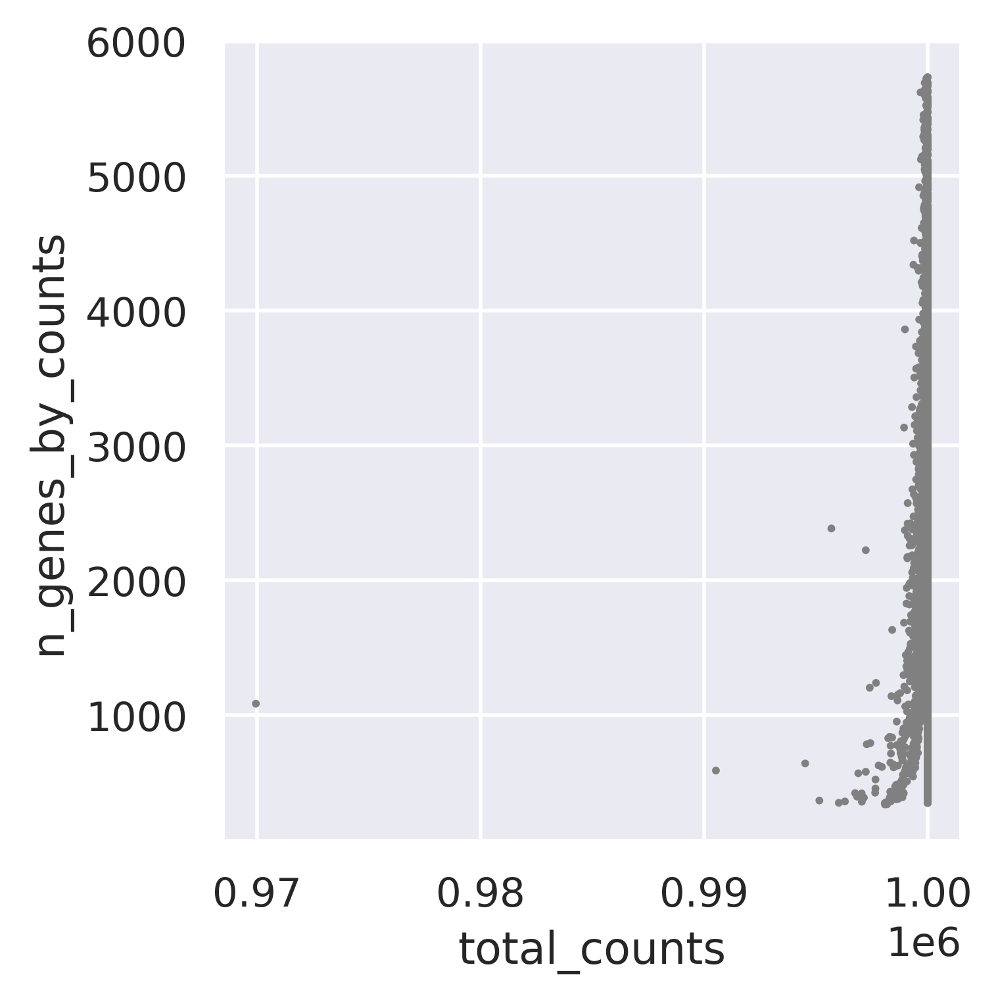

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (5990, 14855)


In [16]:
sample_number_afterfilter = 0
for _file in all_files:

    print('#----------------------------------------------')
    print('Deal with {}...'.format(_file))
    current_sample = all_dataset[all_dataset.obs['sample_id']==_file, :]
    print(type(current_sample.X))
    current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, target_sum=1e6,
                                              max_n_genes_by_counts=8000, max_pct_counts_mt=10, max_total_counts=1e6+100, log_base=2, 
                                              filter_genes=True, min_cells=10)   
    sample_number_afterfilter += current_sample_normalized.shape[0]
    current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))


In [20]:
print(sample_number_afterfilter)

20244


In [18]:

sample2dataset = {}
for _file in all_files:

    current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
    current_dataset = sc.read_h5ad(current_file_path, backed=None)
    if current_dataset.shape[0] >= 1:
        # current_dataset.obs['sample'] = _file    
        sample2dataset[_file] = current_dataset
    else:
        print('Remove file {} with shape: {}'.format(_file, current_dataset.shape()))

In [21]:
sample2dataset[_file].obs

,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
cell_name,,,,,,,,
AAACCCAAGTTTCGGT.1_6,patient #6,Fibroblast,1992,1992,1991,9.998871e+05,63776.949994,6.378415
AAACCCAGTCTAGATC.1_6,patient #6,Malignant,3270,3270,3270,1.000000e+06,50698.628381,5.069863
AAACCCATCCATCAGA.1_6,patient #6,Malignant,2719,2719,2717,9.997611e+05,34396.273737,3.440449
AAACGAAAGCAACAGC.1_6,patient #6,Malignant,3221,3221,3221,1.000000e+06,74228.261723,7.422826
AAACGAACAATCGCAT.1_6,patient #6,Malignant,2739,2739,2739,1.000000e+06,41817.196532,4.181720
...,...,...,...,...,...,...,...,...
TTTGTTGGTTAGAAGT.1_6,patient #6,Malignant,3921,3921,3921,1.000000e+06,33392.274211,3.339227
TTTGTTGTCAAACCCA.1_6,patient #6,Malignant,1301,1301,1301,1.000000e+06,24221.453287,2.422145
TTTGTTGTCAGACTGT.1_6,patient #6,Malignant,3966,3966,3966,1.000000e+06,32251.736179,3.225174



2 mergering all samples together
https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.htmlr

In [22]:
len(sample2dataset)

6

In [23]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
count=0
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    count+=1
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')

    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')


dealing with patient #1


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


dealing with patient #2
dealing with patient #3
dealing with patient #4
dealing with patient #5


In [24]:
all_dataset

AnnData object with n_obs × n_vars = 20244 × 15501
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0', 'mt-0-0-0-0-0', 'n_cells_by_counts-0-0-0-0-0', 'mean_counts-0-0-0-0-0', 'pct_dropout_by_counts-0-0-0-0-0', 'total_counts-0-0-0-0-0', 'n_cells-1-0-0-0-0', 'mt-1-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0', 'mean_counts-1-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0', 'total_counts-1-0-0-0-0', 'n_cells-1-0-0-0', 'mt-1-0-0-0', 'n_cells_by_counts-1-0-0-0', 'mean_counts-1-0-0-0', 'pct_dropout_by_counts-1-0-0-0', 'total_counts-1-0-0-0', 'n_cells-1-0-0', 'mt-1-0-0', 'n_cells_by_counts-1-0-0', 'mean_counts-1-0-0', 'pct_dropout_by_counts-1-0-0', 'total_counts-1-0-0', 'n_cells-1-0', 'mt-1-0', 'n_cells_by_counts-1-0', 'mean_counts-1-0', 'pct_dropout_by_counts-1-0', 'total_counts-1-0', 'n_cells-1', 'mt-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts

In [25]:
print(all_dataset.shape)
all_dataset.obs

(20244, 15501)


,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
cell_name,,,,,,,,,
AAACCTGAGTGTTTGC.1_1,patient #1,Epithelial,2617,2617,2616,9.999130e+05,25502.654713,2.550487,0
AAACCTGCAGTCAGCC.1_1,patient #1,Malignant,4624,4624,4619,9.998390e+05,51989.441154,5.199781,0
AAACCTGGTACATGTC.1_1,patient #1,Malignant,2531,2531,2529,9.998530e+05,64667.842446,6.467735,0
AAACCTGGTCGGCATC.1_1,patient #1,Epithelial,3196,3196,3195,9.999362e+05,27387.640449,2.738939,0
AAACCTGGTGCAGACA.1_1,patient #1,Epithelial,2851,2851,2848,9.997704e+05,38496.862085,3.850570,0
...,...,...,...,...,...,...,...,...,...
TTTGTTGGTTAGAAGT.1_6,patient #6,Malignant,3921,3921,3921,1.000000e+06,33392.274211,3.339227,1
TTTGTTGTCAAACCCA.1_6,patient #6,Malignant,1301,1301,1301,1.000000e+06,24221.453287,2.422145,1
TTTGTTGTCAGACTGT.1_6,patient #6,Malignant,3966,3966,3966,1.000000e+06,32251.736179,3.225174,1


In [26]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0,mt-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0,mean_counts-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0,total_counts-0-0-0-0-0,n_cells-1-0-0-0-0,mt-1-0-0-0-0,n_cells_by_counts-1-0-0-0-0,mean_counts-1-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
gene_name,,,,,,,,,,,,,,,,,,,,,
A1BG,860.0,False,860.0,27.783478,71.542025,83961.671645,45.0,False,45.0,3.973657,...,2238.0,47.100409,74.246260,409302.556635,2672.0,False,2672.0,55.734673,59.533545,368016.042699
A1BG-AS1,82.0,False,82.0,1.798014,97.286565,5433.598573,NaN,NaN,NaN,NaN,...,186.0,2.978165,97.859609,25880.253621,378.0,False,378.0,5.562636,94.275329,36730.082588


In [27]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0': 'n_cells'})
all_dataset.var.head(2), all_dataset.var.shape

(           n_cells  total_counts-1
 gene_name                         
 A1BG         860.0   368016.042699
 A1BG-AS1      82.0    36730.082588,
 (15501, 2))

In [28]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}.h5ad'))

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [29]:
gene_list_in_bulk = pd.read_csv(r'../data/3CA/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [30]:
common_marker_gene = pd.read_csv('../data/3CA/selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(178, 6)


,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [31]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(14464, 156, (19814, 11), (15501, 2))

In [32]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [33]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 20244 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


18.875


AnnData object with n_obs × n_vars = 20244 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

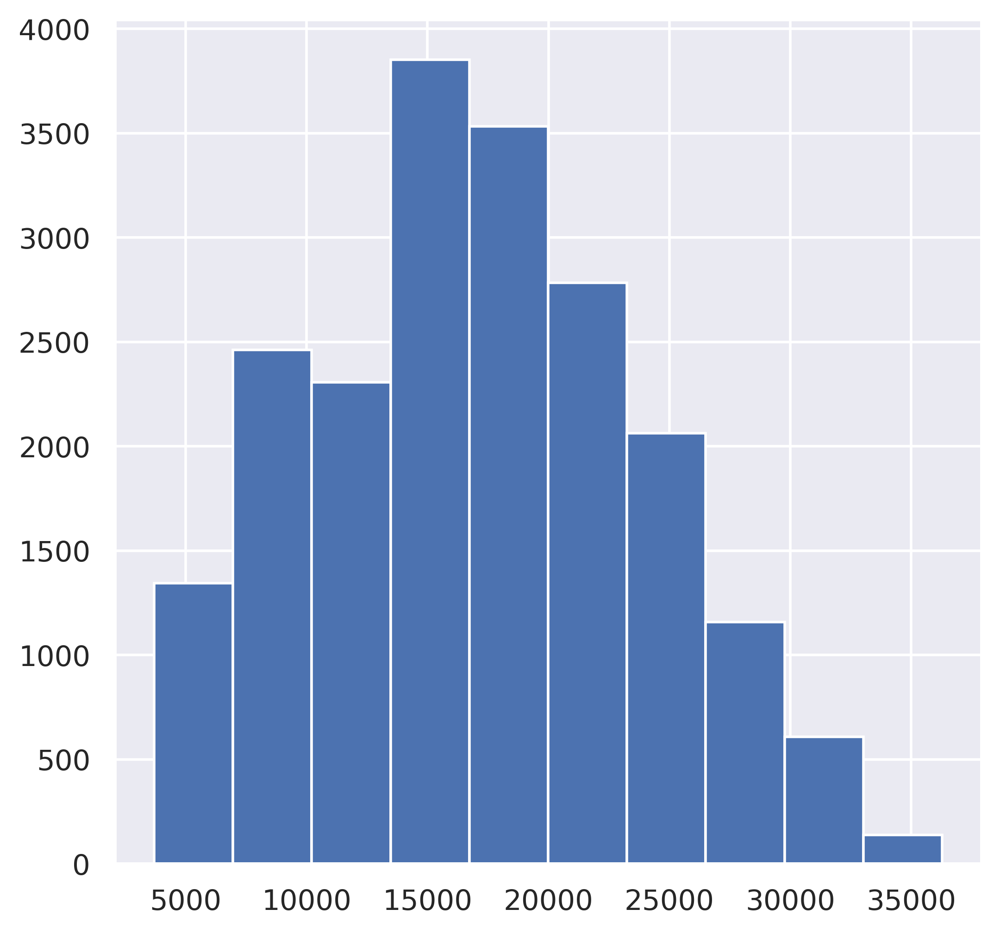

In [34]:
data = pd.DataFrame(all_dataset.X.todense())
data = log_exp2cpm(exp_df=data, log_base=2, correct=1)
data = non_log2log_cpm(input_file_path=data,  correct=1,transpose =False)
all_dataset_1 = an.AnnData(data)
all_dataset_1.X = csr_matrix(all_dataset_1.X)
all_dataset_1.obs = all_dataset.obs
all_dataset_1.var = all_dataset.var
all_dataset = all_dataset_1.copy()
print(data.max().max())  #check 
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))
all_dataset

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [35]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

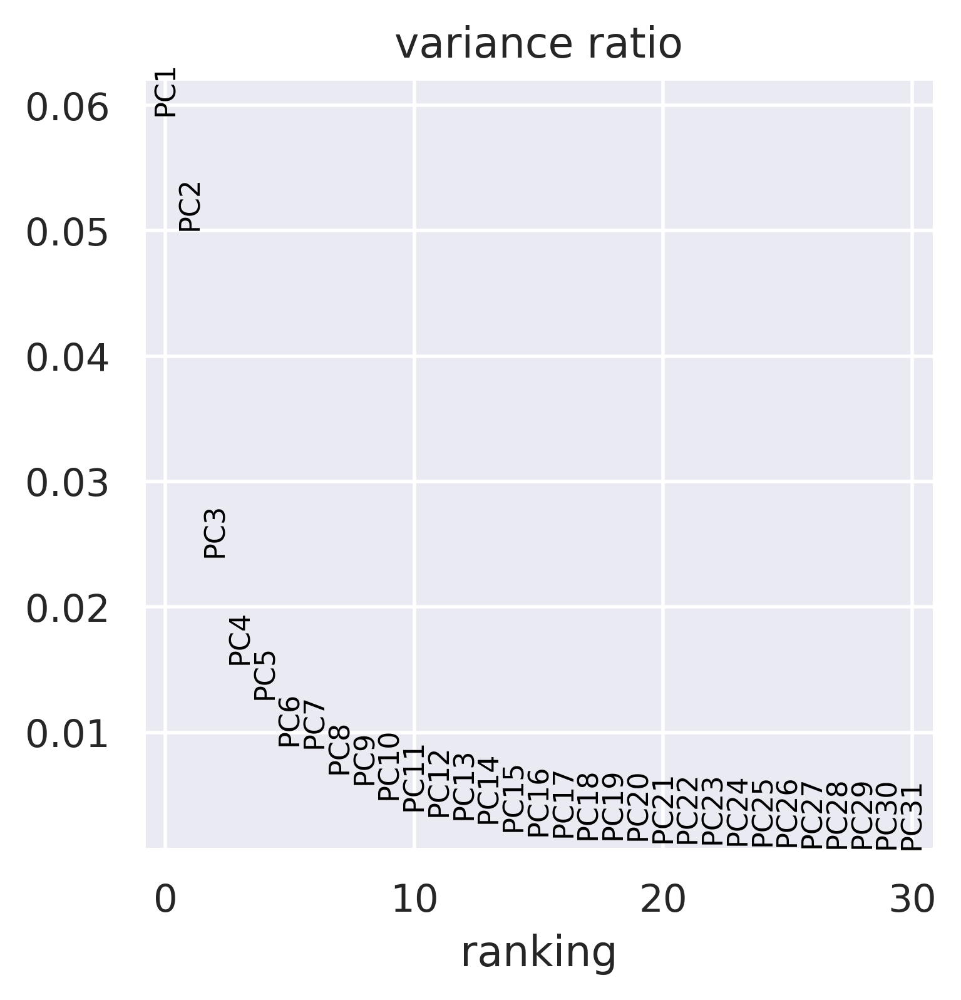

In [36]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [37]:
all_dataset.obsm['X_pca'].shape

(20244, 100)

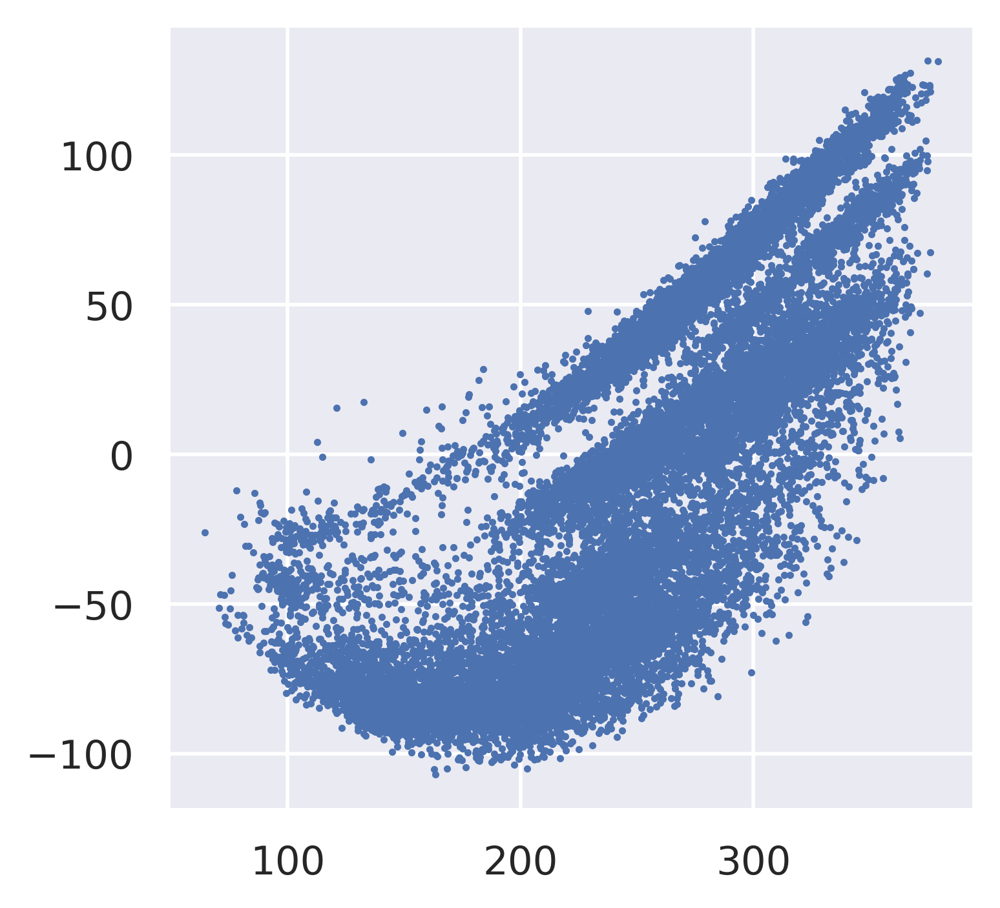

In [38]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1],s=1)

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [39]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [40]:
sc.tl.umap(all_dataset)

In [41]:
all_dataset

AnnData object with n_obs × n_vars = 20244 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [42]:
sc.tl.leiden(all_dataset)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


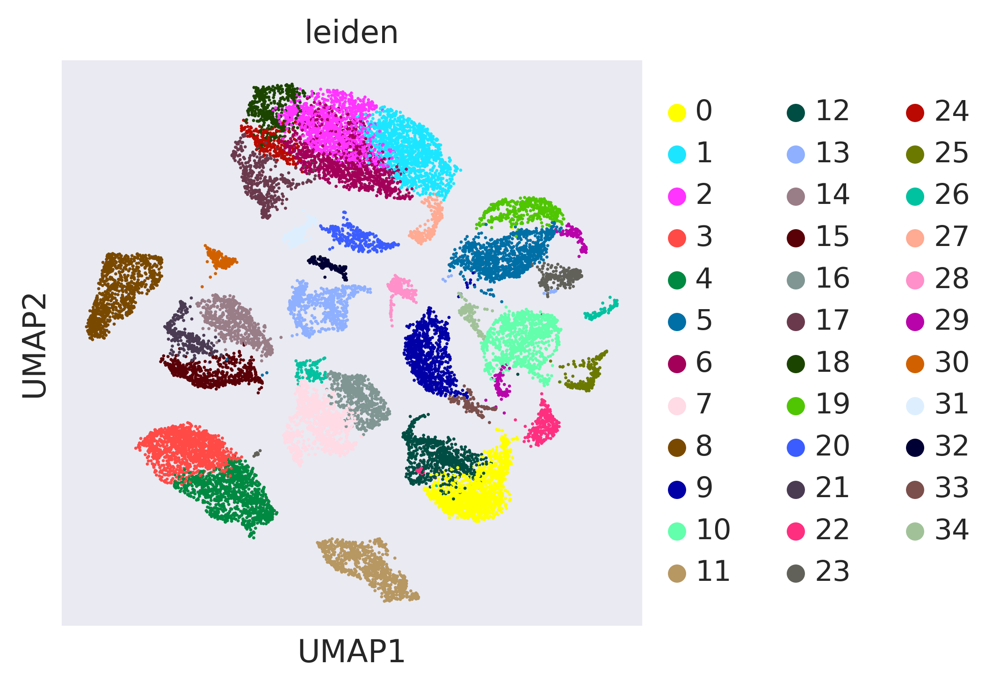

In [43]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

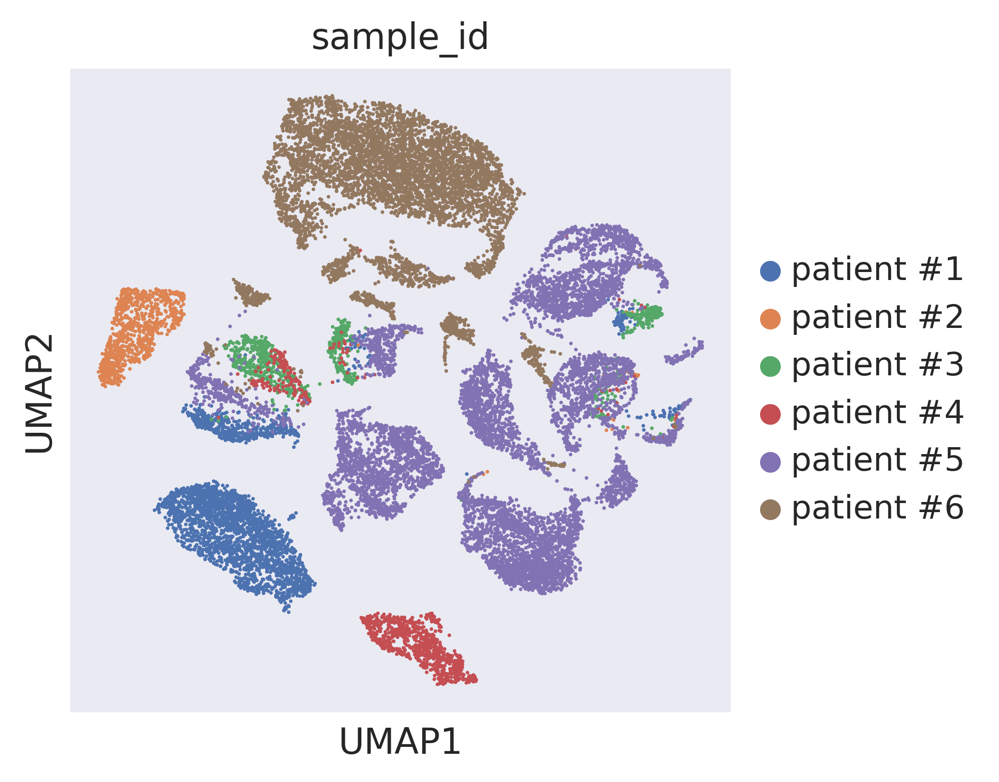

In [44]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [45]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

5. Batch effect correction by BBKNN¶
https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [ ]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

In [46]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')

CPU times: user 8.86 s, sys: 243 ms, total: 9.1 s
Wall time: 3.73 s


In [47]:
all_dataset

AnnData object with n_obs × n_vars = 20244 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'sample_id_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [48]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

CPU times: user 28.1 s, sys: 11.7 s, total: 39.8 s
Wall time: 25 s


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


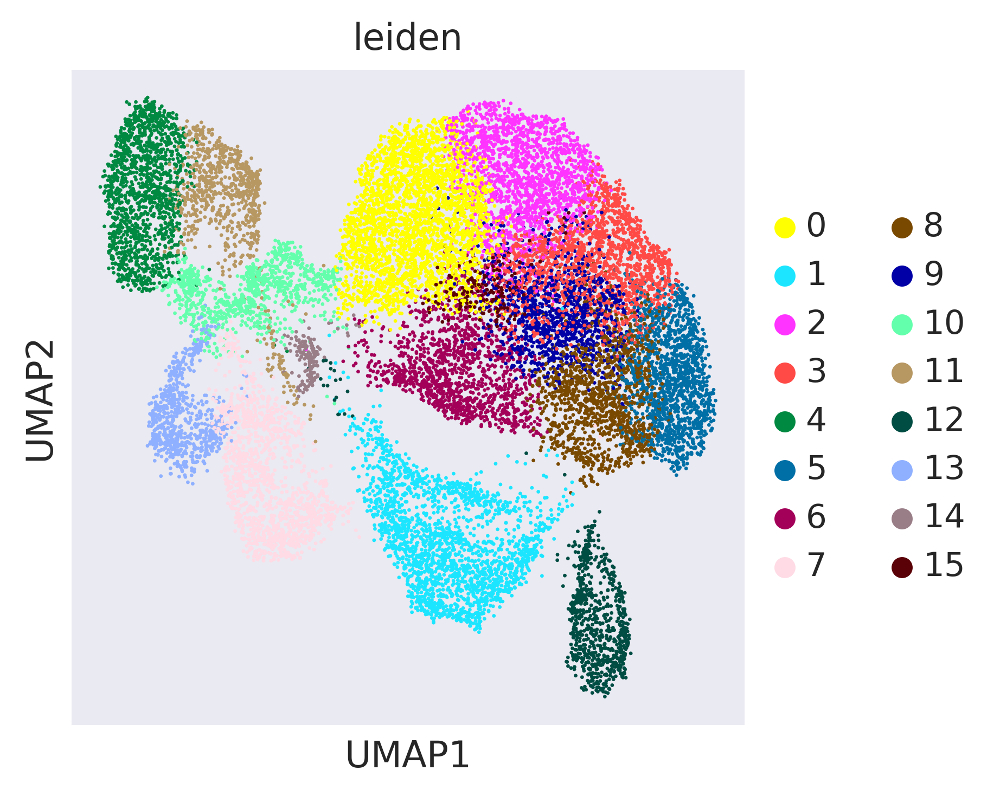

In [49]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

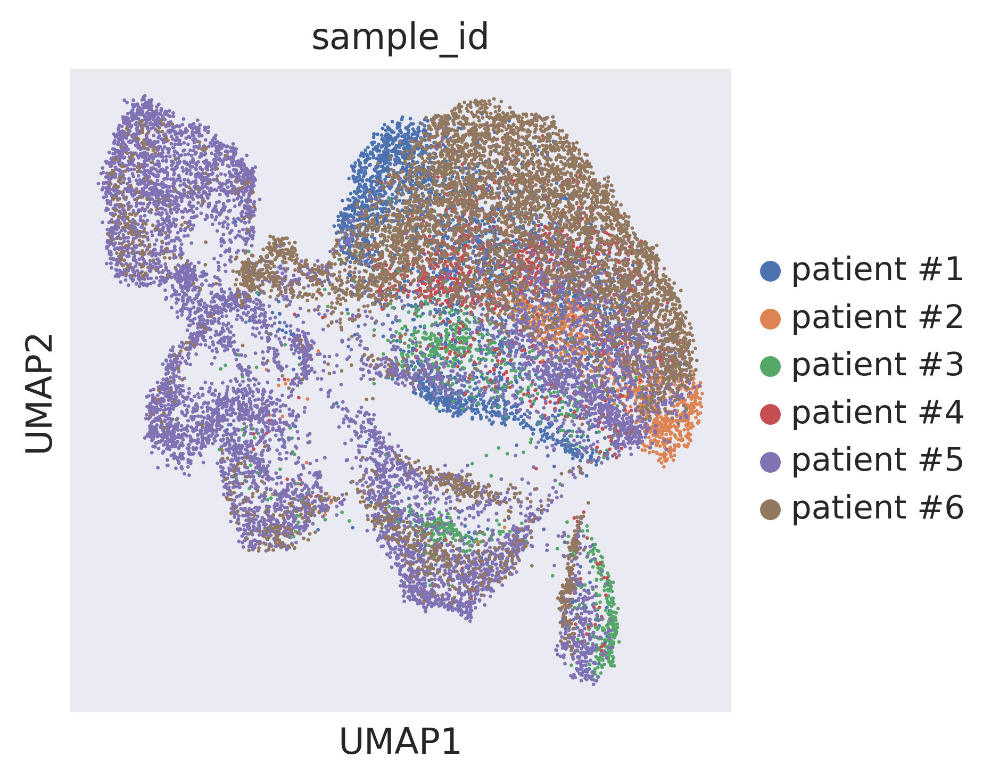

In [50]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

In [51]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

### 6. Finding marker genes

In [85]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

In [86]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [87]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,RPS18,IGFBP7,RPS5,AR,CXCR4,UBE2S,KRT19,TYROBP,TACSTD2,H2AFV,RPS23,HLA-A,GNG11,TPSB2,SSR4,SCGN
1,RPL3,MGP,RPS15,PDLIM5,BTG1,STMN1,TACSTD2,FCER1G,KRT19,PPDPF,TPT1,B2M,RAMP2,LTC4S,FKBP11,CPE
2,RPL36,CALD1,RPS2,MYO6,RPS29,HMGB3,SLPI,LAPTM5,FXYD3,SIVA1,CD79A,CD3D,RNASE1,ALOX5AP,MZB1,SSR4
3,RPS2,TIMP1,RPL12,FOLH1,HLA-A,DEK,MMP7,CD74,SPINT2,HMGN2,HLA-DQA1,CXCR4,ECSCR,NFKBIA,HERPUD1,PCSK1N
4,AR,LGALS1,RPL36,PPP3CA,B2M,HMGN2,S100A11,FTL,SMIM22,CDKN2A,RPL11,CD2,PECAM1,MS4A2,SEC11C,SEZ6L2
5,RPL12,COL1A2,RPL6,EPCAM,SRGN,WDR34,TM4SF1,HLA-DRA,PERP,CHCHD2,PTMA,ARHGDIB,VWF,SRGN,DERL3,CHGA
6,RPL30,BGN,RPS18,MZT2A,CD52,H1FX,WFDC2,HLA-DPB1,CDH1,DEK,EEF1B2,TMSB4X,FKBP1A,CLU,FKBP2,FKBP2
7,RPS10,IFITM3,RPL3,CLDN7,CCL5,PAFAH1B3,ANXA2,CYBA,KRT8,SRP9,RPL14,IL32,SPARCL1,FXYD5,XBP1,SCG2
8,RPS5,TPM2,RPLP0,NKX3-1,HSP90AA1,UBE2T,FXYD3,CD68,MAL2,STMN1,VPREB3,SRGN,CRIP2,FCER1G,SSR3,OR51E1
9,RPS15,COL6A2,TIMM13,SPDEF,RPLP2,NUCKS1,ZFP36L1,HLA-DPA1,DHCR24,LSM4,RPS27A,HLA-B,PLVAP,HPGDS,CYBA,CD81


In [88]:
common_marker_gene = pd.read_csv(r'../data/3CA/selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [89]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print('Cells number of current cluster: {}'.format(all_dataset.obs['leiden'].value_counts()[cluster_id]))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
Cells number of current cluster: 2899
           0         cell_type
14  PPP1R14B                DC
25      RPL8  Epithelial Cells
Current cluster id: 1
Cells number of current cluster: 2120
         1    cell_type
5   COL1A2  Fibroblasts
11    MYL9  Fibroblasts
13  COL1A1  Fibroblasts
16  COL3A1  Fibroblasts
26     DCN  Fibroblasts
Current cluster id: 2
Cells number of current cluster: 1789
           2         cell_type
21  PPP1R14B                DC
27    MRPL12  Epithelial Cells
Current cluster id: 3
Cells number of current cluster: 1635
        3         cell_type
5   EPCAM  Epithelial Cells
20  KRT18  Epithelial Cells
20  KRT18  Epithelial Cells
Current cluster id: 4
Cells number of current cluster: 1462
       4 cell_type
7   CCL5     CD8 T
14  CD3D   T Cells
15  IL7R     CD4 T
21  CD3E   T Cells
25   CD2   T Cells
Current cluster id: 5
Cells number of current cluster: 1457
Empty DataFrame
Columns: [5, cell_type]
Index: []
Current cluster id: 6
Cells number

In [90]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4","CXCL13",  "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2",     
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                  "FOXP3","CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T                                                        
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [91]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "FCRLA", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "CLEC4C", "IRF8", "MZB1", "CD40", # DC
                 "CDH5", "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "DCN", "FAP", "LUM", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "CMA1", "MS4A2", "TPSAB1", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [92]:

list_marker1 = set(all_dataset.var.index) & set(marker_genes1)
missing_gene = set(marker_genes1)-set(list_marker1)
print(f'Marker gene {missing_gene} of marker_genes1 list are missing.')
for i in missing_gene:
    marker_genes1.remove(i)
len(marker_genes1)

Marker gene set() of marker_genes1 list are missing.


50

In [93]:
list_marker2 = set(all_dataset.var.index) & set(marker_genes2)
missing_gene = set(marker_genes2)-set(list_marker2)
print(f'Marker gene {missing_gene} of marker_genes2 list are missing.')
for i in missing_gene:
    marker_genes2.remove(i)
len(marker_genes2)

Marker gene {'CMA1', 'CDH5', 'CLEC4C', 'FCGR3B', 'CD80', 'MS4A1', 'TPSAB1'} of marker_genes2 list are missing.


48

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


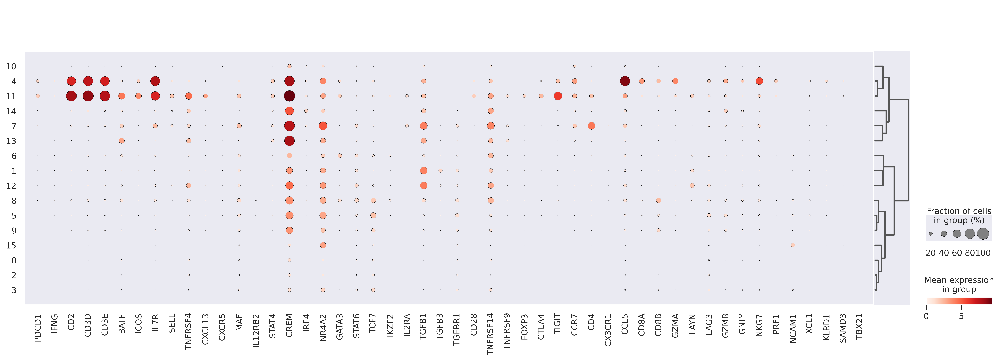

In [94]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


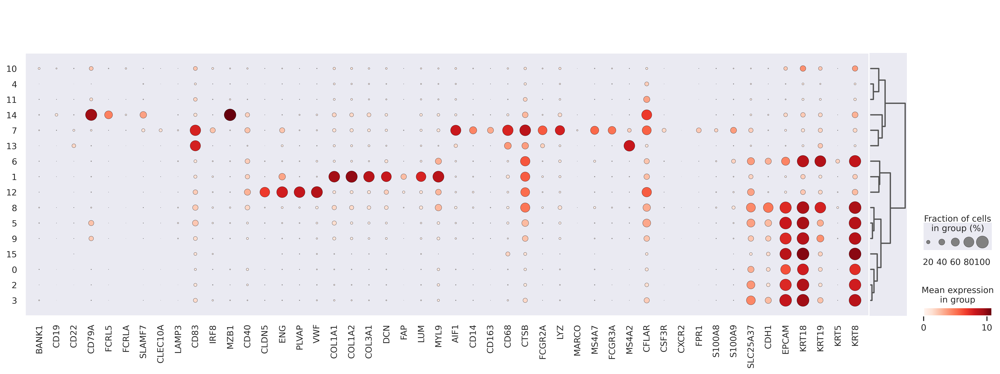

In [95]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)


In [96]:
#  Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0: 'Epithelial Cells (1)',
    1: 'Fibroblasts',
    2: 'Epithelial Cells (2)',
    3: 'Epithelial Cells (3)',
    4: 'CD8 T / CD4 T',    
    5: 'Malignant',
    6: 'Epithelial Cells (4)',
    7: 'Macrophages',    
    8: 'Epithelial Cells (5)',
    9: 'Epithelial Cells (6)',
    10: 'B Cells (1)',
    11: "CD4 T",             
    12: 'Endothelial Cells',
    13: 'Mast Cells',   
    14: 'B Cells (2)', 
    15: 'Endocrine cells'      
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['Epithelial Cells (1)', 'Fibroblasts', 'Epithelial Cells (2)', 'Epithelial Cells (3)', 'CD8 T / CD4 T', 'Malignant', 'Epithelial Cells (4)', 'Macrophages', 'Epithelial Cells (5)', 'Epithelial Cells (6)', 'B Cells (1)', 'CD4 T', 'Endothelial Cells', 'Mast Cells', 'B Cells (2)', 'Endocrine cells']


In [97]:
all_dataset.obs['leiden'].value_counts()

Epithelial Cells (1)    2899
Fibroblasts             2120
Epithelial Cells (2)    1789
Epithelial Cells (3)    1635
CD8 T / CD4 T           1462
Malignant               1457
Epithelial Cells (4)    1388
Macrophages             1363
Epithelial Cells (5)    1312
Epithelial Cells (6)    1215
B Cells (1)              971
CD4 T                    813
Endothelial Cells        775
Mast Cells               727
B Cells (2)              171
Endocrine cells          147
Name: leiden, dtype: int64

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


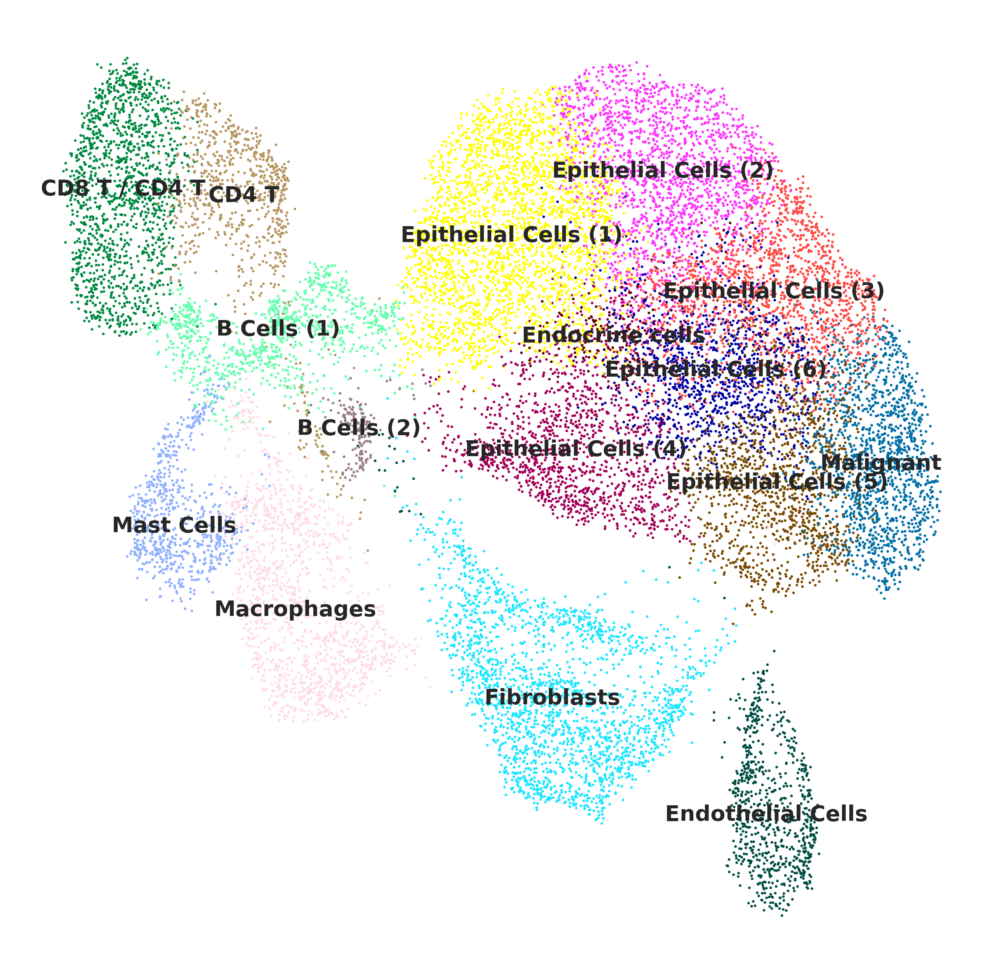

In [98]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

In [99]:
all_dataset

AnnData object with n_obs × n_vars = 20244 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [100]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))

#### Comparing original cell type and annotated cell type

In [101]:
all_dataset.obs['cell_type'].value_counts()

Malignant      9459
nan            5630
Fibroblast     1957
Epithelial     1458
Myeloid         736
Endothelial     582
Lymphoid        422
Name: cell_type, dtype: int64

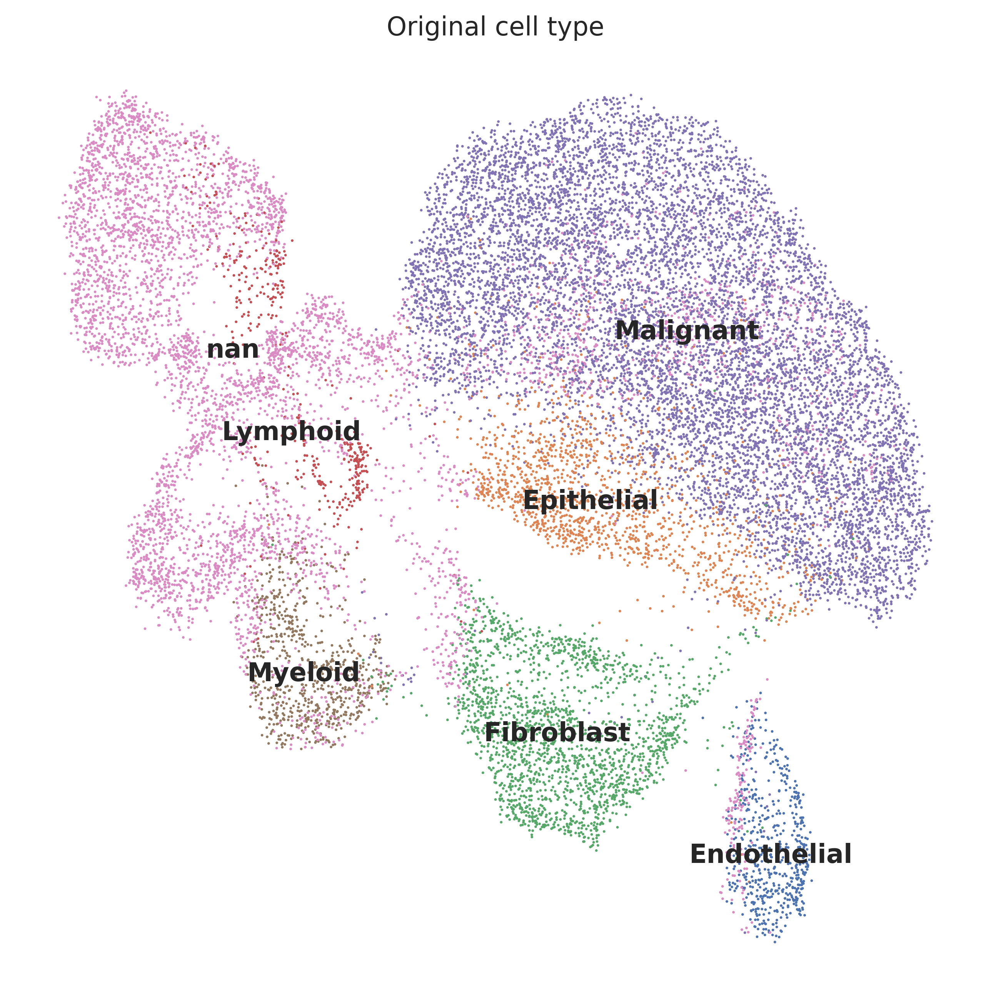

In [102]:
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [103]:
sorted(list(all_dataset.obs.leiden.unique()))

['B Cells (1)',
 'B Cells (2)',
 'CD4 T',
 'CD8 T / CD4 T',
 'Endocrine cells',
 'Endothelial Cells',
 'Epithelial Cells (1)',
 'Epithelial Cells (2)',
 'Epithelial Cells (3)',
 'Epithelial Cells (4)',
 'Epithelial Cells (5)',
 'Epithelial Cells (6)',
 'Fibroblasts',
 'Macrophages',
 'Malignant',
 'Mast Cells']

In [104]:
cell_type_mapping = {
'B Cells (1)':'Lymphoid' ,
 'B Cells (2)':'Lymphoid' ,
 'CD4 T': 'Lymphoid',
 'CD8 T / CD4 T': 'Lymphoid',
 'Endocrine cells': 'Cancer Cells',
 'Endothelial Cells': 'Endothelial Cells',
 'Epithelial Cells (1)': 'Cancer Cells',
 'Epithelial Cells (2)': 'Cancer Cells',
 'Epithelial Cells (3)': 'Cancer Cells',
 'Epithelial Cells (4)':'Cancer Cells' ,
 'Epithelial Cells (5)':'Cancer Cells' ,
 'Epithelial Cells (6)': 'Cancer Cells',
 'Fibroblasts': 'Fibroblasts',
 'Macrophages': 'Myeloid',
 'Malignant': 'Cancer Cells',
 'Mast Cells': 'Mast Cells'
}


In [105]:
all_dataset.obs['cell_type'].unique()

['Epithelial', 'Malignant', 'nan', 'Fibroblast', 'Endothelial', 'Lymphoid', 'Myeloid']
Categories (7, object): ['Epithelial', 'Malignant', 'nan', 'Fibroblast', 'Endothelial', 'Lymphoid', 'Myeloid']

In [106]:
cell_type_mapping_original = {
    'Epithelial': 'Cancer Cells' ,
    'Malignant':  'Cancer Cells', 
    'nan': 'nan', 
    'Fibroblast':'Fibroblasts' ,
    'Endothelial':'Endothelial Cells' , 
    'Lymphoid':'Lymphoid' ,  
    'Myeloid':  'Myeloid'  
}

In [107]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping)
all_dataset.obs['original_cell_type'] = all_dataset.obs['cell_type'].map(cell_type_mapping_original)
all_dataset.obs.head(2)

,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
cell_name,,,,,,,,,,,,
AAACCTGAGTGTTTGC.1_1,patient #1,Epithelial,2617,2617,2616,999912.960223,25502.654713,2.550487,0,Epithelial Cells (4),Cancer Cells,Cancer Cells
AAACCTGCAGTCAGCC.1_1,patient #1,Malignant,4624,4624,4619,999839.041978,51989.441154,5.199781,0,Malignant,Cancer Cells,Cancer Cells


In [110]:
obs_bool =( all_dataset.obs['cell_type1'] == all_dataset.obs['original_cell_type'])|(all_dataset.obs['cell_type1'] =='nan')|(all_dataset.obs['original_cell_type'] =='nan')
print(sum(obs_bool))
all_dataset = all_dataset[obs_bool, :].copy()

20079


In [111]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

Epithelial Cells (1) 0.868 2898
Fibroblasts 0.913 2086
Epithelial Cells (2) 0.979 1788
Epithelial Cells (3) 0.764 1635
CD8 T / CD4 T 0.001 1462
Malignant 0.973 1453
Epithelial Cells (4) 0.952 1385
Macrophages 0.561 1301
Epithelial Cells (5) 0.959 1296
Epithelial Cells (6) 0.998 1215
B Cells (1) 0.0 969
CD4 T 0.318 807
Endothelial Cells 0.775 748
Mast Cells 0.0 724
B Cells (2) 0.782 165
Endocrine cells 0.973 147


In [112]:
all_dataset.obs['leiden'].value_counts()

Epithelial Cells (1)    2898
Fibroblasts             2086
Epithelial Cells (2)    1788
Epithelial Cells (3)    1635
CD8 T / CD4 T           1462
Malignant               1453
Epithelial Cells (4)    1385
Macrophages             1301
Epithelial Cells (5)    1296
Epithelial Cells (6)    1215
B Cells (1)              969
CD4 T                    807
Endothelial Cells        748
Mast Cells               724
B Cells (2)              165
Endocrine cells          147
Name: leiden, dtype: int64

In [113]:
all_dataset

AnnData object with n_obs × n_vars = 20079 × 14465
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


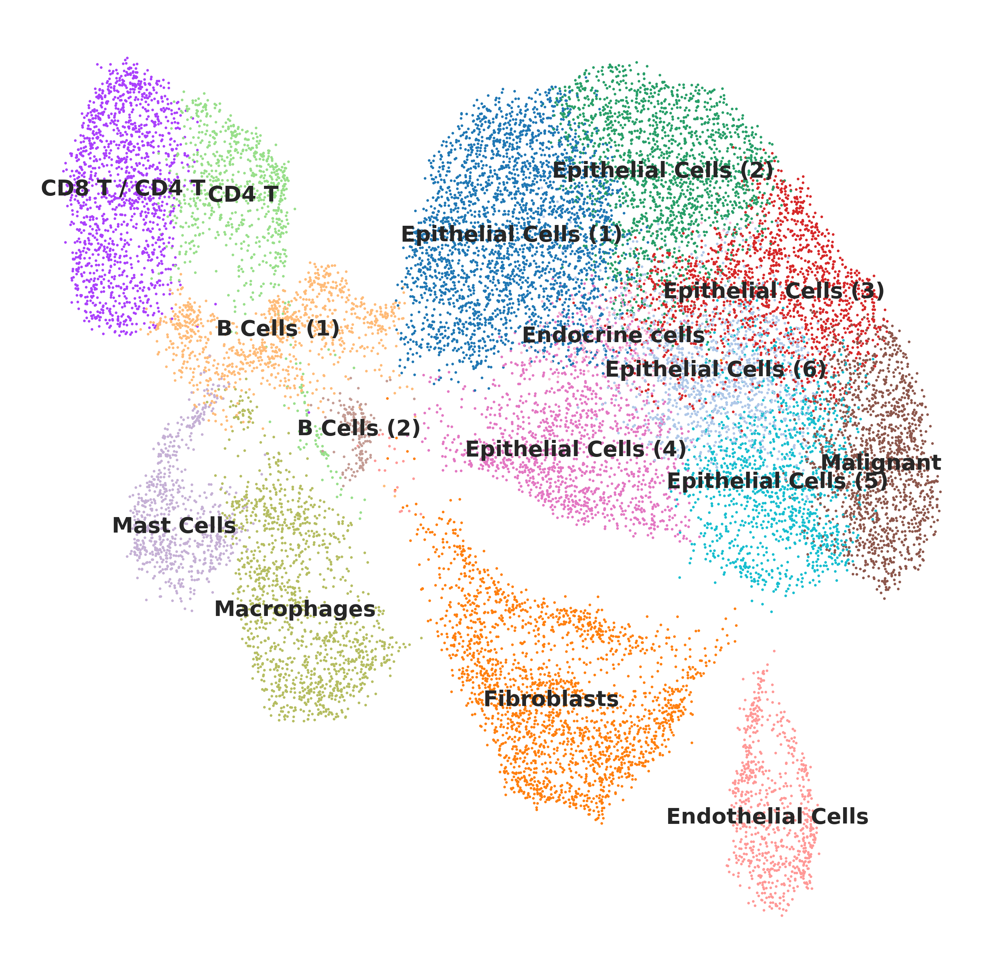

In [114]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_new.png')

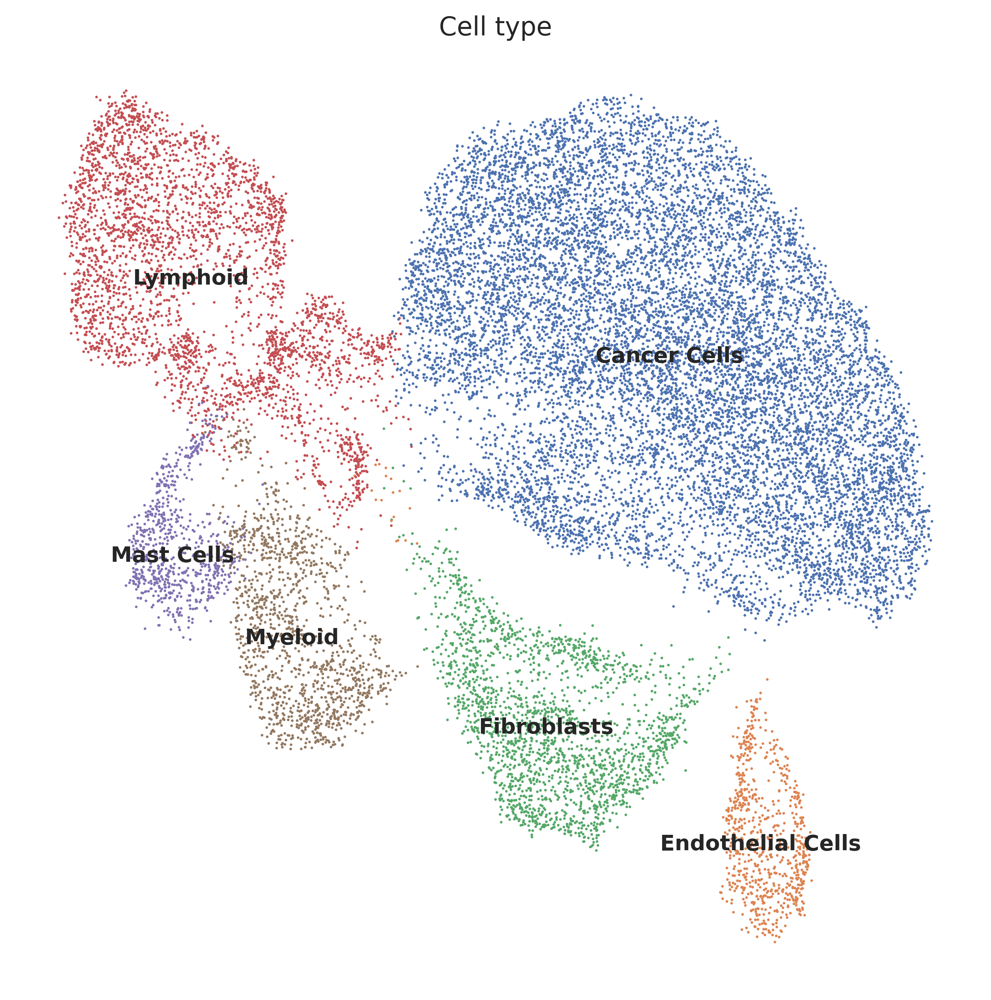

In [115]:
sc.pl.umap(all_dataset, color='cell_type1', legend_loc='on data', legend_fontsize='small', 
           title='Cell type', frameon=False)

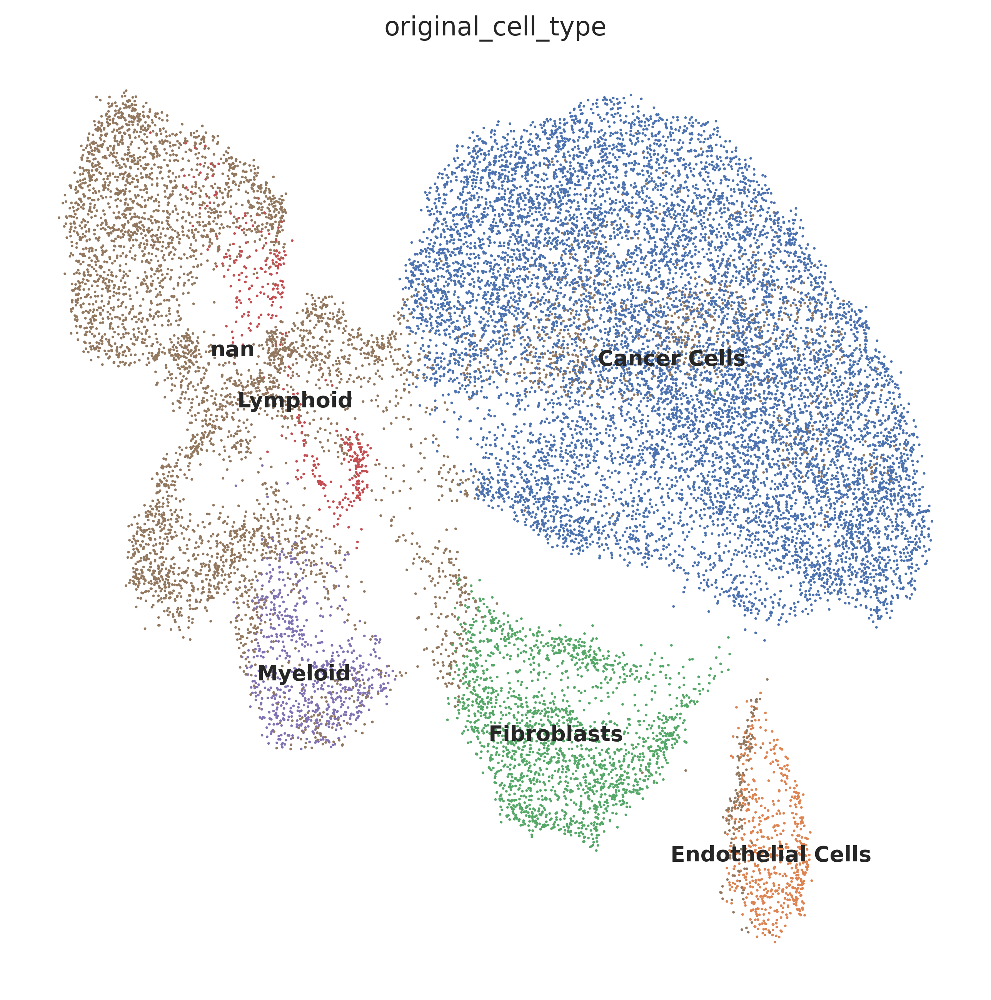

In [116]:
sc.pl.umap(all_dataset, color='original_cell_type', legend_loc='on data', legend_fontsize='small', 
           title='original_cell_type', frameon=False)

In [117]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))